#Preliminars

## Imports

In [ ]:
import numpy as np
import pandas as pd
import random
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torch.nn.functional as F
from torchvision import models
import torchvision.transforms as tt
from torchvision.utils import save_image, make_grid
from torchvision.datasets import ImageFolder 
from torch.utils.data import Dataset,DataLoader
import cv2
from PIL import Image, ImageOps, ImageEnhance
from tqdm.notebook import tqdm
!pip install opendatasets --upgrade --quiet
import opendatasets as od
import matplotlib.pyplot as plt
%matplotlib inline
from scipy import linalg
from torch.nn.functional import adaptive_avg_pool2d

## directories

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# Create images and checkpoint directories

#dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_Landscapes'
#dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_portaitsNoAugment'
#dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_portraits150_400'
#dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_portraits150_augmented'
dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/lsGan_augmented'

#complete_checkpoints_directory=dir+'/total_checkpoints'
#generated_images_directory=dir+'generated_images'
#checkpoints_directory=dir+'/checkpoints'

generated_images_directory='/content/gdrive/MyDrive/VISIOPE/FinalProject/lsGan_augmented/generated_images'
complete_checkpoints_directory='/content/gdrive/MyDrive/VISIOPE/FinalProject/lsGan_augmented/total_checkpoints'



In [ ]:
if not os.path.exists(checkpoints_directory):
   os.makedirs(checkpoints_directory)

if not os.path.exists(generated_images_directory):
   os.makedirs(generated_images_directory)

if not os.path.exists(complete_checkpoints_directory):
  os.makedirs(complete_checkpoints_directory)

##Hyper-parameters

In [ ]:
img_size=64

# size of image height
img_height = 64
# size of image width
img_width = 64

# size of the batches
batch_size = 64

# random noise
noise_size=100 

# device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# fixed noise
torch.manual_seed(100)
fixed_noise = torch.randn(batch_size, noise_size, 1, 1, device=device)


transform=tt.Compose([tt.Resize((img_height,img_width)), 
                      #tt.CenterCrop((img_height,img_width)),
                      tt.RandomHorizontalFlip(),
                      tt.ToTensor(),
                      tt.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
                      ])

#Dataset

In [ ]:
#dataset_directory='/content/gdrive/MyDrive/VISIOPE/datasets/resized150/resized150'
#dataset_directory='/content/gdrive/MyDrive/VISIOPE/datasets/landscapes'
dataset_directory='/content/gdrive/MyDrive/VISIOPE/datasets/total_portraits/portrait'

In [ ]:
def augmentation(image):
   
    # change saturation randomly
    add_remove_saturation = random.uniform(-0.3,0.3)
    editor = ImageEnhance.Color(image)
    image = editor.enhance(1+add_remove_saturation)

    # random sharpness adjustment
    add_remove_sharpness = random.uniform(-0.3,0.3)
    editor = ImageEnhance.Sharpness(image)
    image = editor.enhance(1+add_remove_sharpness)
    
    mirror = random.randint(0,1)
    if mirror==1:
        image = ImageOps.mirror(image)
    
    return image

In [ ]:
class CustomDataSet(Dataset):
    def __init__(self, root_directory, transform, augment):
        self.root_directory = root_directory
        self.transform = transform
        self.augment=augment
        self.all_images = os.listdir(root_directory)

    def __len__(self):
        return len(self.all_images)

    def __getitem__(self, index):
        img=self.all_images[index]
        img_path = os.path.join(self.root_directory,img)
        image = Image.open(img_path).convert('RGB') 
        transformed_image = self.transform(image)
        if self.augment:
           image = augmentation(image)
        image = self.transform(image)
        return image

## auxiliary functions

In [ ]:
from matplotlib.widgets import Slider
from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
from IPython.display import display
from PIL import Image


def show_images(dataset):
  output_image = (make_grid(dataset, nrow=8).permute(1, 2, 0).detach().numpy())
  output_image = output_image * 0.5 + 0.5
  output_image = output_image * 255.0
  output_image = output_image.astype(int)

  fig = plt.figure(figsize=(8, 8), facecolor="w")
  plt.imshow(output_image)
  plt.axis("off")
  plt.show()



def build_slider(img_dir,title):
  images = []

  def show_image(epoch):
    
    fig=plt.imshow(images[epoch])
    plt.title(title)
    fig.axes.get_xaxis().set_visible(False)
    fig.axes.get_yaxis().set_visible(False)
    plt.show()

  for filename in os.listdir(img_dir):
        img = Image.open(os.path.join(img_dir, filename))
        
        images.append(img) 
  %matplotlib inline
  interact(show_image, epoch=widgets.IntSlider(min=0, max=len(images)-1, step=1, value=0))

## Dataloader

In [ ]:
dataset = CustomDataSet(dataset_directory, transform, augment=True)

In [ ]:
dataloader = DataLoader(dataset, batch_size, shuffle=True, pin_memory=True)

In [ ]:
images = next(iter(dataloader))

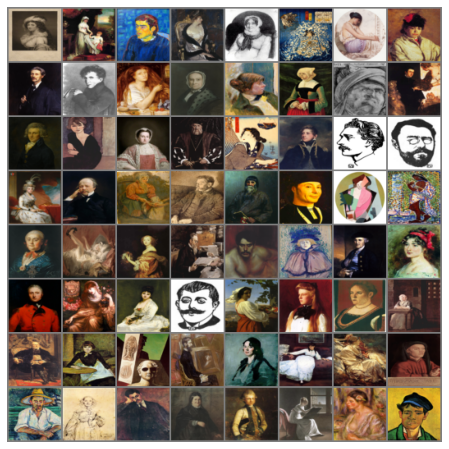

In [ ]:
show_images(images)

# DcGan model

## Discriminator

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, d=64):
        super(Discriminator, self).__init__()

        self.discriminator=nn.Sequential(
            nn.Conv2d(3, d, 4, 2, 1),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(d, d*2, 4, 2, 1),
            nn.BatchNorm2d(d*2),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(d*2, d*4, 4, 2, 1),
            nn.BatchNorm2d(d*4),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(d*4, d*8, 4, 2, 1),
            nn.BatchNorm2d(d*8),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(d*8, 1, 4, 1, 0),
            #nn.Sigmoid()                  # comment for LSGan and RelGan
        )

    def forward(self,x):
        return self.discriminator(x)

## Generator

In [ ]:
class Generator(nn.Module):
    def __init__(self,noise_size,d=64):
        super(Generator, self).__init__()


        self.generator=nn.Sequential(
            nn.ConvTranspose2d(noise_size, d*8, 4, 1, 0),
            nn.BatchNorm2d(d*8),
            nn.ReLU(),

            nn.ConvTranspose2d(d*8, d*4, 4, 2, 1),
            nn.BatchNorm2d(d*4),
            nn.ReLU(),

            nn.ConvTranspose2d(d*4, d*2, 4, 2, 1),
            nn.BatchNorm2d(d*2),
            nn.ReLU(),

            nn.ConvTranspose2d(d*2, d, 4, 2, 1),
            nn.BatchNorm2d(d),
            nn.ReLU(),

            nn.ConvTranspose2d(d, 3, 4, 2, 1),
            nn.Tanh()
        )


    def forward(self, x):
        return self.generator(x)

## initialize

In [ ]:
# Initialize generator and discriminator
generator = Generator(noise_size)
discriminator = Discriminator()

generator=generator.to(device)
discriminator=discriminator.to(device)

## Initialize weights/load weights

### initialize weights

In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, "bias") and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

In [ ]:
# Initialize weights
generator.apply(weights_init_normal)    
discriminator.apply(weights_init_normal)

Discriminator(
  (discriminator): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1))
  )
)

### load checkpoints

In [ ]:
# Load pretrained model
discriminator.load_state_dict(torch.load(f"{checkpoints_directory}/D-{100}.pth"))
generator.load_state_dict(torch.load(f"{checkpoints_directory}/G-{100}.pth"))


# Training the models 


## Training Parameters

In [ ]:
# epoch to start training from
start_index = 1

# number of epochs of training
epochs = 400

# Loss
criterion = nn.BCELoss()
criterion = criterion.to(device)

# Loss for LSGan
#criterion = nn.MSELoss()
#criterion = criterion.to(device)

# Loss for RelGan
#criterion = nn.BCEWithLogitsLoss()
#criterion = criterion.to(device)

# learning rate
lr = 0.0002 

# Optimizers
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))

## fid score



fid score is a metric that evaluates the difference between the features extracted by  a batch of real images and fake images generated by our model, the features are encoded and then re-decoded in an array of 2048 elements, that is considered as a multivariate distribution.

the parameters of the distribution is computed and then computed the FID SCORE ${d^2 = ||\mu_1 – \mu_2||^2 + Tr\biggl[C_1 + C_2 – 2\sqrt{C_1*C_2}\biggl]}$



the implementation, that is an adaptation of the official one  is taken from https://github.com/mseitzer/pytorch-fid

In [ ]:
class InceptionV3(nn.Module):
    """Pretrained InceptionV3 network returning feature maps"""

    # Index of default block of inception to return,
    # corresponds to output of final average pooling
    DEFAULT_BLOCK_INDEX = 3

    # Maps feature dimensionality to their output blocks indices
    BLOCK_INDEX_BY_DIM = {
        64: 0,   # First max pooling features
        192: 1,  # Second max pooling featurs
        768: 2,  # Pre-aux classifier features
        2048: 3  # Final average pooling features
    }

    def __init__(self,
                 output_blocks=[DEFAULT_BLOCK_INDEX],
                 resize_input=True,
                 normalize_input=True,
                 requires_grad=False):
        
        super(InceptionV3, self).__init__()

        self.resize_input = resize_input
        self.normalize_input = normalize_input
        self.output_blocks = sorted(output_blocks)
        self.last_needed_block = max(output_blocks)

        assert self.last_needed_block <= 3, \
            'Last possible output block index is 3'

        self.blocks = nn.ModuleList()

        
        inception = models.inception_v3(pretrained=True)

        # Block 0: input to maxpool1
        block0 = [
            inception.Conv2d_1a_3x3,
            inception.Conv2d_2a_3x3,
            inception.Conv2d_2b_3x3,
            nn.MaxPool2d(kernel_size=3, stride=2)
        ]
        self.blocks.append(nn.Sequential(*block0))

        # Block 1: maxpool1 to maxpool2
        if self.last_needed_block >= 1:
            block1 = [
                inception.Conv2d_3b_1x1,
                inception.Conv2d_4a_3x3,
                nn.MaxPool2d(kernel_size=3, stride=2)
            ]
            self.blocks.append(nn.Sequential(*block1))

        # Block 2: maxpool2 to aux classifier
        if self.last_needed_block >= 2:
            block2 = [
                inception.Mixed_5b,
                inception.Mixed_5c,
                inception.Mixed_5d,
                inception.Mixed_6a,
                inception.Mixed_6b,
                inception.Mixed_6c,
                inception.Mixed_6d,
                inception.Mixed_6e,
            ]
            self.blocks.append(nn.Sequential(*block2))

        # Block 3: aux classifier to final avgpool
        if self.last_needed_block >= 3:
            block3 = [
                inception.Mixed_7a,
                inception.Mixed_7b,
                inception.Mixed_7c,
                nn.AdaptiveAvgPool2d(output_size=(1, 1))
            ]
            self.blocks.append(nn.Sequential(*block3))

        for param in self.parameters():
            param.requires_grad = requires_grad

    def forward(self, inp):
        """Get Inception feature maps
        Parameters
        ----------
        inp : torch.autograd.Variable
            Input tensor of shape Bx3xHxW. Values are expected to be in
            range (0, 1)
        Returns
        -------
        List of torch.autograd.Variable, corresponding to the selected output
        block, sorted ascending by index
        """
        outp = []
        x = inp

        if self.resize_input:
            x = F.interpolate(x,
                              size=(299, 299),
                              mode='bilinear',
                              align_corners=False)

        if self.normalize_input:
            x = 2 * x - 1  # Scale from range (0, 1) to range (-1, 1)

        for idx, block in enumerate(self.blocks):
            x = block(x)
            if idx in self.output_blocks:
                outp.append(x)

            if idx == self.last_needed_block:
                break

        return outp
    
block_idx = InceptionV3.BLOCK_INDEX_BY_DIM[2048]
inception = InceptionV3([block_idx])
inception = inception.to(device)

In [ ]:
def calculate_activation_statistics(images,model,batch_size=64, dims=2048,
                    cuda=False):
    model.eval()
    act=np.empty((len(images), dims))
    
    if cuda:
        batch=images.cuda()
    else:
        batch=images
    pred = model(batch)[0]

        # If model output is not scalar, apply global spatial average pooling.
        # This happens if you choose a dimensionality not equal 2048.
    if pred.size(2) != 1 or pred.size(3) != 1:
        pred = adaptive_avg_pool2d(pred, output_size=(1, 1))

    act= pred.cpu().data.numpy().reshape(pred.size(0), -1)
    
    mu = np.mean(act, axis=0)
    sigma = np.cov(act, rowvar=False)
    return mu, sigma

In [ ]:
def calculate_frechet_distance(mu1, sigma1, mu2, sigma2, eps=1e-6):
    """Numpy implementation of the Frechet Distance.
    The Frechet distance between two multivariate Gaussians X_1 ~ N(mu_1, C_1)
    and X_2 ~ N(mu_2, C_2) is
            d^2 = ||mu_1 - mu_2||^2 + Tr(C_1 + C_2 - 2*sqrt(C_1*C_2)).
    """

    mu1 = np.atleast_1d(mu1)
    mu2 = np.atleast_1d(mu2)

    sigma1 = np.atleast_2d(sigma1)
    sigma2 = np.atleast_2d(sigma2)

    assert mu1.shape == mu2.shape, \
        'Training and test mean vectors have different lengths'
    assert sigma1.shape == sigma2.shape, \
        'Training and test covariances have different dimensions'

    diff = mu1 - mu2

    
    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if not np.isfinite(covmean).all():
        msg = ('fid calculation produces singular product; '
               'adding %s to diagonal of cov estimates') % eps
        print(msg)
        offset = np.eye(sigma1.shape[0]) * eps
        covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))

    
    if np.iscomplexobj(covmean):
        if not np.allclose(np.diagonal(covmean).imag, 0, atol=1e-3):
            m = np.max(np.abs(covmean.imag))
            raise ValueError('Imaginary component {}'.format(m))
        covmean = covmean.real

    tr_covmean = np.trace(covmean)

    return (diff.dot(diff) + np.trace(sigma1) +
            np.trace(sigma2) - 2 * tr_covmean)

In [ ]:
def compute_fid(images_real,images_fake):
     mu_1,std_1=calculate_activation_statistics(images_real,inception,cuda=True)
     mu_2,std_2=calculate_activation_statistics(images_fake,inception,cuda=True)
    
     """get fretched distance"""
     fid_value = calculate_frechet_distance(mu_1, std_1, mu_2, std_2)
     return fid_value

## Train DcGan

In [ ]:
def model_fit(data, epochs, start_idx):

  if(start_idx==1):

    arr_losses_generator = []
    arr_losses_discriminator = []
    arr_scores_real_imgs = []
    arr_scores_fake_imgs= []
    arr_fid_scores=[]

  else:
    checkpoint = torch.load(f"{complete_checkpoints_directory}/Checkpoint{start_idx-1}.tar")
    generator.load_state_dict(checkpoint['generator_checkpoints'])
    discriminator.load_state_dict(checkpoint['discriminator_checkpoints'])
    optimizer_G.load_state_dict(checkpoint['generator_optimizer'])
    optimizer_D.load_state_dict(checkpoint['discriminator_optimizer'])
    arr_losses_generator = checkpoint['generator_losses']
    arr_losses_discriminator = checkpoint['discriminator_losses']
    arr_scores_real_imgs = checkpoint['scores_on_real_imgs']
    arr_scores_fake_imgs= checkpoint['scores_on_fake_imgs']
    arr_fid_scores=checkpoint['fid_score']



  for epoch in range(epochs):
    
    generator.train()
    discriminator.train()

    losses_generator = 0.0
    losses_discriminator = 0.0
    fid_scores=[]

    tqdm_bar = tqdm(data, desc=f'Training Epoch {epoch+start_idx} ', total=int(len(data)))

    for index, real_images in enumerate(tqdm_bar):
      real_images = real_images.to(device)
    
      random_noise = torch.randn(batch_size, noise_size, 1, 1, device=device)

      # training the discriminator                                               
      optimizer_D.zero_grad()
      
      real_predictions=discriminator(real_images).squeeze()                              
      real_labels = torch.ones_like(real_predictions,device=device)               
      loss_real_imgs = criterion(real_predictions, real_labels)
    
      # loss of the discriminator on fake images
      fake_predictions = discriminator(generator(random_noise).detach())
      fake_labels = torch.zeros_like(fake_predictions)    
      loss_fake_imgs = criterion(fake_predictions, fake_labels)
      
      discriminator_loss =  (loss_real_imgs + loss_fake_imgs) *0.5 
      discriminator_loss.backward()
      optimizer_D.step()

      # train generator                                                          
      optimizer_G.zero_grad()

      # generate fake images
      fake_imgs = generator(random_noise)

      # compute the loss
      generator_predictions = discriminator(fake_imgs).squeeze()
      generator_labels = torch.ones_like(generator_predictions)                 
      generator_loss=criterion(generator_predictions, generator_labels)
      
      # Update generator weights
      generator_loss.backward()
      optimizer_G.step()

      losses_generator +=generator_loss.item()
      losses_discriminator+=discriminator_loss.item()
      fid_scores.append(compute_fid(fake_imgs, real_images)) 

      tqdm_bar.set_postfix(Gen_loss=losses_generator/(index+1), Disc_loss=losses_discriminator/(index+1))
      
      
    score_fake_imgs = torch.mean(fake_predictions).item()
    score_real_imgs = torch.mean(real_predictions).item()
      
    arr_losses_generator.append(generator_loss.item())
    arr_losses_discriminator.append(discriminator_loss.item())
    arr_scores_real_imgs.append(score_real_imgs)
    arr_scores_fake_imgs.append(score_fake_imgs)
    arr_fid_scores.append(np.mean(fid_scores))


    with torch.no_grad():
      fake_images = generator(fixed_noise)  

    image_name = 'generated-images-{0:0=4d}.png'.format(epoch+start_idx)
    save_image(fake_images, os.path.join(generated_images_directory, image_name), normalize=True, nrow=8)
  
    torch.save({
            'generator_checkpoints': generator.state_dict(),
            'discriminator_checkpoints': discriminator.state_dict(),
            'discriminator_optimizer':  optimizer_D.state_dict(),
            'generator_optimizer': optimizer_G.state_dict(),
            'fid_score': arr_fid_scores,
            'last_fid': fid,
            'generator_losses': arr_losses_generator,
            'discriminator_losses': arr_losses_discriminator,
            'scores_on_real_imgs': arr_scores_real_imgs,
            'scores_on_fake_imgs':arr_scores_fake_imgs,
            'epoch': epoch+start_index
            },f"{complete_checkpoints_directory}/Checkpoint{epoch+start_idx}.tar" )
    

  return np.mean(fid_scores),arr_fid_scores, arr_losses_generator, arr_losses_discriminator, arr_scores_real_imgs, arr_scores_fake_imgs 



In [ ]:
run = model_fit(dataloader, epochs, start_index)

Training Epoch 1 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 2 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 3 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 4 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 5 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 6 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 7 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 8 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 9 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 10 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 11 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 12 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 13 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 14 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 15 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 16 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 17 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 18 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 19 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 20 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 21 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 22 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 23 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 24 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 25 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 26 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 27 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 28 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 29 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 30 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 31 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 32 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 33 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 34 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 35 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 36 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 37 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 38 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 39 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 40 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 41 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 42 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 43 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 44 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 45 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 46 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 47 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 48 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 49 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 50 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 51 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 52 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 53 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 54 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 55 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 56 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 57 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 58 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 59 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 60 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 61 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 62 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 63 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 64 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 65 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 66 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 67 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 68 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 69 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 70 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 71 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 72 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 73 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 74 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 75 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 76 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 77 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 78 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 79 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 80 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 81 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 82 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 83 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 84 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 85 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 86 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 87 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 88 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 89 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 90 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 91 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 92 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 93 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 94 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 95 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 96 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 97 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 98 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 99 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 100 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 101 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 102 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 103 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 104 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 105 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 106 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 107 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 108 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 109 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 110 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 111 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 112 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 113 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 114 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 115 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 116 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 117 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 118 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 119 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 120 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 121 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 122 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 123 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 124 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 125 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 126 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 127 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 128 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 129 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 130 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 131 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 132 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 133 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 134 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 135 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 136 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 137 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 138 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 139 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 140 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 141 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 142 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 143 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 144 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 145 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 146 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 147 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 148 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 149 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 150 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 151 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 152 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 153 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 154 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 155 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 156 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 157 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 158 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 159 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 160 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 161 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 162 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 163 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 164 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 165 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 166 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 167 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 168 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 169 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 170 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 171 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 172 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 173 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 174 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 175 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 176 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 177 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 178 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 179 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 180 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 181 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 182 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 183 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 184 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 185 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 186 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 187 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 188 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 189 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 190 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 191 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 192 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 193 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 194 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 195 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 196 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 197 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 198 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 199 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 200 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 201 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 202 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 203 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 204 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 205 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 206 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 207 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 208 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 209 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 210 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 211 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 212 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 213 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 214 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 215 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 216 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 217 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 218 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 219 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 220 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 221 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 222 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 223 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 224 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 225 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 226 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 227 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 228 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 229 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 230 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 231 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 232 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 233 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 234 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 235 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 236 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 237 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 238 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 239 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 240 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 241 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 242 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 243 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 244 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 245 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 246 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 247 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 248 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 249 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 250 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 251 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 252 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 253 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 254 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 255 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 256 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 257 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 258 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 259 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 260 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 261 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 262 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 263 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 264 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 265 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 266 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 267 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 268 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 269 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 270 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 271 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 272 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 273 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 274 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 275 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 276 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 277 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 278 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 279 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 280 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 281 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 282 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 283 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 284 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 285 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 286 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 287 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 288 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 289 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 290 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 291 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 292 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 293 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 294 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 295 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 296 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 297 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 298 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 299 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 300 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 301 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 302 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 303 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 304 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 305 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 306 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 307 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 308 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 309 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 310 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 311 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 312 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 313 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 314 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 315 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 316 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 317 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 318 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 319 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 320 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 321 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 322 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 323 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 324 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 325 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 326 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 327 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 328 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 329 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 330 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 331 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 332 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 333 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 334 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 335 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 336 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 337 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 338 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 339 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 340 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 341 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 342 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 343 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 344 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 345 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 346 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 347 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 348 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 349 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 350 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 351 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 352 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 353 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 354 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 355 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 356 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 357 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 358 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 359 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 360 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 361 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 362 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 363 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 364 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 365 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 366 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 367 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 368 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 369 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 370 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 371 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 372 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 373 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 374 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 375 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 376 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 377 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 378 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 379 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 380 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 381 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 382 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 383 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 384 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 385 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 386 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 387 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 388 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 389 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 390 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 391 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 392 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 393 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 394 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 395 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 396 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 397 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 398 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 399 :   0%|          | 0/121 [00:00<?, ?it/s]

Training Epoch 400 :   0%|          | 0/121 [00:00<?, ?it/s]

## Train Relativistic Gan


In [ ]:
def model_fit(data, epochs, start_idx):

  if(start_idx==1):

    arr_losses_generator = []
    arr_losses_discriminator = []
    arr_fid_scores=[]

  else:
    checkpoint = torch.load(f"{complete_checkpoints_directory}/Checkpoint{start_idx-1}.tar")
    generator.load_state_dict(checkpoint['generator_checkpoints'])
    discriminator.load_state_dict(checkpoint['discriminator_checkpoints'])
    optimizer_G.load_state_dict(checkpoint['generator_optimizer'])
    optimizer_D.load_state_dict(checkpoint['discriminator_optimizer'])
    arr_losses_generator = checkpoint['generator_losses']
    arr_losses_discriminator = checkpoint['discriminator_losses']
    arr_fid_scores=checkpoint['fid_score']


  for epoch in range(epochs):
    losses_generator = 0.0
    losses_discriminator = 0.0
    fid_scores=[]

    tqdm_bar = tqdm(data, desc=f'Training Epoch {epoch+start_index} ', total=int(len(data)))
    for index, real_images in enumerate(tqdm_bar):
      real_images = real_images.to(device)

      random_noise = torch.randn(batch_size, noise_size, 1, 1, device=device) 

      # train generator
      generator.train()
      optimizer_G.zero_grad()
      
      # generate fake images
      fake_imgs = generator(random_noise)

      # compute the loss
      generator_predictions = discriminator(fake_imgs).squeeze()
      generator_labels = torch.ones_like(generator_predictions)
      generator_predictions_real = discriminator(real_images).squeeze()
      generator_loss = criterion(generator_predictions - generator_predictions_real, generator_labels) 
      # Update generator weights
      generator_loss.backward()
      optimizer_G.step()

      # training the discriminator
      discriminator.train()
      optimizer_D.zero_grad()
      
      # loss of the discriminator on real images 
      real_predictions = discriminator(real_images).squeeze()
      real_labels = torch.ones_like(real_predictions)   
  
    
      # loss of the discriminator fake images
      fake_predictions = discriminator(fake_imgs.detach()).squeeze()
      fake_labels = torch.zeros_like(fake_predictions)    

      discriminator_loss = 0.5 * (
            criterion(real_predictions - fake_predictions, real_labels) +
            criterion(fake_predictions - real_predictions, fake_labels))
      
      discriminator_loss.backward()
      optimizer_D.step()

      #advancing...
      losses_generator +=generator_loss.item()
      losses_discriminator+=discriminator_loss.item()
      fid_scores.append(compute_fid(fake_imgs, real_images))
      tqdm_bar.set_postfix(Gen_loss=losses_generator/(index+1), Disc_loss=losses_discriminator/(index+1))
 
    arr_losses_generator.append(generator_loss.item())
    arr_losses_discriminator.append(discriminator_loss.item())
    arr_fid_scores.append(np.mean(fid_scores))

    with torch.no_grad():
      fake_images = generator(fixed_noise) 
    
    image_name = 'generated-images-{0:0=4d}.png'.format(epoch+start_idx)
    save_image(fake_images, os.path.join(generated_images_directory, image_name), normalize=True, nrow=8)  

    torch.save({
          'generator_checkpoints': generator.state_dict(),
          'discriminator_checkpoints': discriminator.state_dict(),
          'discriminator_optimizer':  optimizer_D.state_dict(),
          'generator_optimizer': optimizer_G.state_dict(),
          'fid_score': arr_fid_scores,
          'last_fid': fid,
          'generator_losses': arr_losses_generator,
          'discriminator_losses': arr_losses_discriminator,
          'epoch': epoch+start_index
          },f"{complete_checkpoints_directory}/Checkpoint{epoch+start_idx}.tar" )                       

  return np.mean(fid_scores), arr_fid_scores, arr_losses_generator, arr_losses_discriminator 

In [ ]:
run = model_fit(dataloader, epochs, start_index)

# Evaluation of the results

## Landscapes

In [ ]:
landscape_dir = '/content/gdrive/MyDrive/VISIOPE/DcGan_Landscapes/generated_images'
build_slider(landscape_dir,"landscapes generated by DC Gan")

interactive(children=(IntSlider(value=0, description='epoch', max=272), Output()), _dom_classes=('widget-inter…

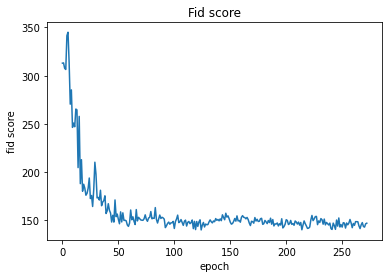

In [ ]:
plt.plot(arr_fid_scores, '-')
plt.xlabel('epoch')
plt.ylabel('fid score')
plt.title('Fid score');

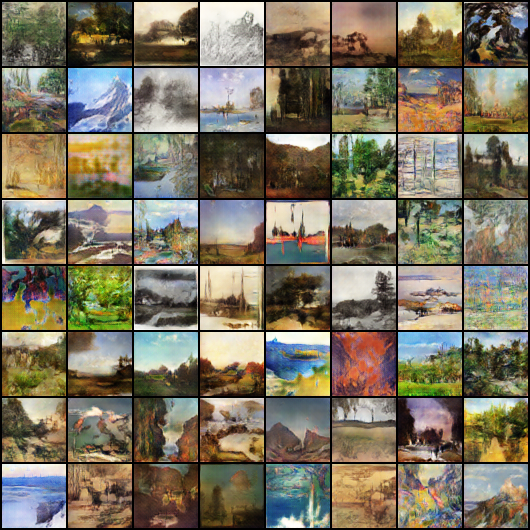

In [ ]:
Image.open(os.path.join(landscape_dir,'generated-images-0125.png'))

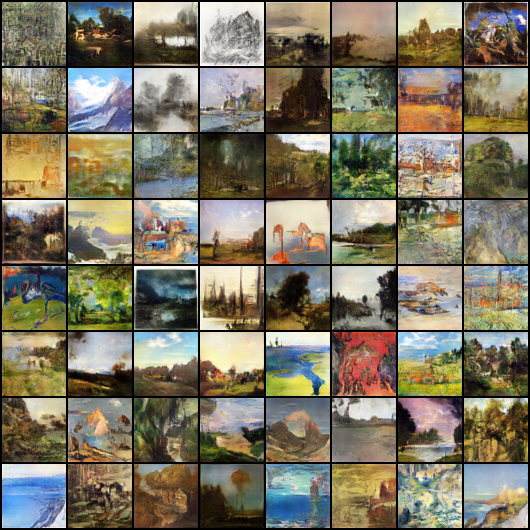

In [ ]:
Image.open(os.path.join(landscape_dir,'generated-images-0267.png'))

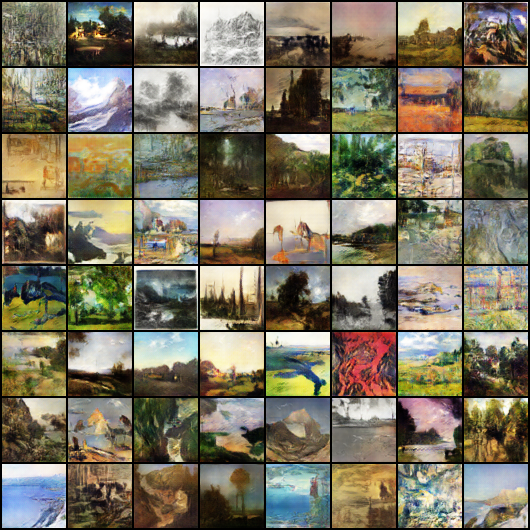

In [ ]:
Image.open(os.path.join(landscape_dir,'generated-images-0273.png'))

## Portraits 

###DcGan model on base dataset 

In [ ]:
portraits0_dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_portaitsNoAugment/generated_images'
build_slider(portraits0_dir,"portraits generated by DC Gan using BCE and Adam")

interactive(children=(IntSlider(value=0, description='epoch', max=229), Output()), _dom_classes=('widget-inter…

In [ ]:
DcGan_complete_checkpoints='/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_portaitsNoAugment/total_checkpoints'
checkpoint = torch.load(f"{DcGan_complete_checkpoints}/Checkpoint{230}.tar")
fid= checkpoint['last_fid']
fid_scores=checkpoint['fid_score']

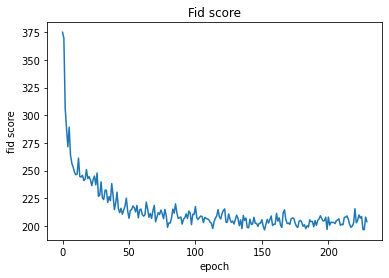

In [ ]:
plt.plot(fid_scores, '-')
plt.xlabel('epoch')
plt.ylabel('fid score')
plt.title('Fid score');

In [ ]:
print(np.argmin(fid_scores)+1)
min(fid_scores)


153


196.32551835166512

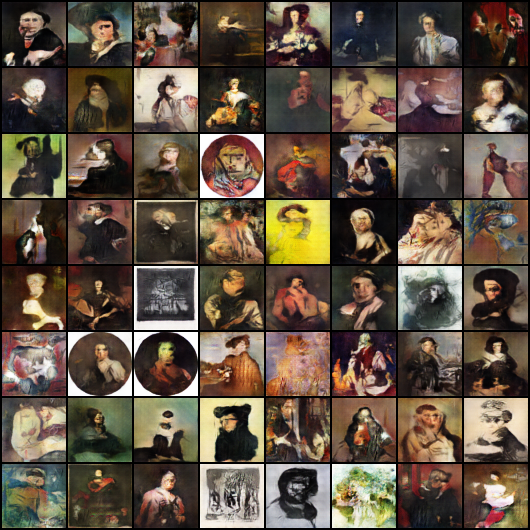

In [ ]:
Image.open(os.path.join(portraits0_dir,'generated-images-0230.png'))

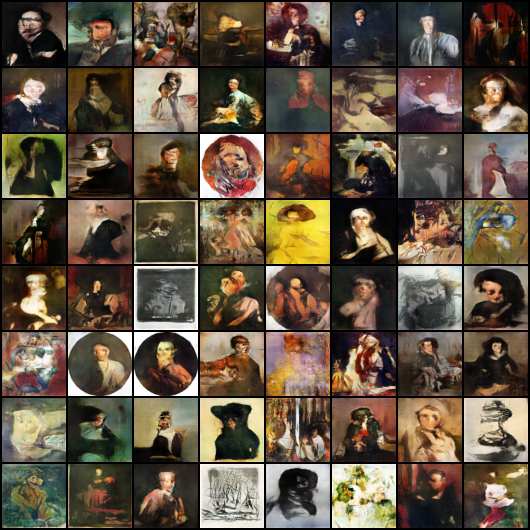

In [ ]:
Image.open(os.path.join(portraits0_dir,'generated-images-{0:0=4d}.png'.format(np.argmin(fid_scores)+1)))

### DcGan model on base portraits dataset with augmentation

In [ ]:
portraits1_dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_portraits_Augmented/generated_images'
build_slider(portraits1_dir,"portraits generated by DC Gan using BCE and Adam with augmentation")

interactive(children=(IntSlider(value=0, description='epoch', max=227), Output()), _dom_classes=('widget-inter…

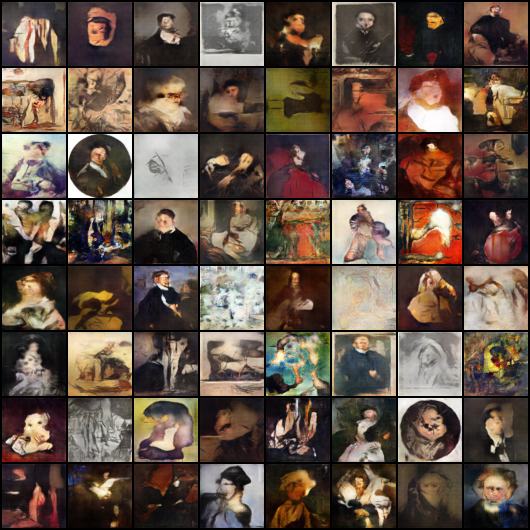

In [ ]:
Image.open('/content/gdrive/MyDrive/VISIOPE/generated_images/totale/DcGanmixed1/generated-image-0228.png')

### DC Gan model on transformed portraits dataset

In [ ]:
DcGan_complete_checkpoints='/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_portraits150_400/total_checkpoints'
checkpoint = torch.load(f"{DcGan_complete_checkpoints}/Checkpoint{400}.tar")
fid= checkpoint['last_fid']
losses_g = checkpoint['generator_losses']
losses_d = checkpoint['discriminator_losses']
fid_scores=checkpoint['fid_score']
real_scores=checkpoint['scores_on_real_imgs']
fake_scores=checkpoint['scores_on_fake_imgs']


In [ ]:
img_dir = '/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_portraits150_400/generated_images'
build_slider(img_dir,"Dc Gan on resized portraits using BCE and Adam optimizer")

interactive(children=(IntSlider(value=0, description='epoch', max=399), Output()), _dom_classes=('widget-inter…

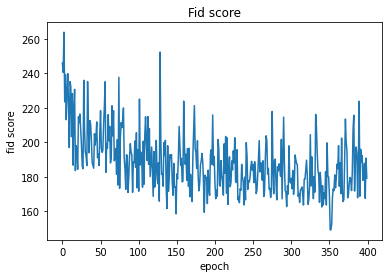

In [ ]:
plt.plot(fid_scores, '-')
plt.xlabel('epoch')
plt.ylabel('fid score')
plt.title('Fid score');

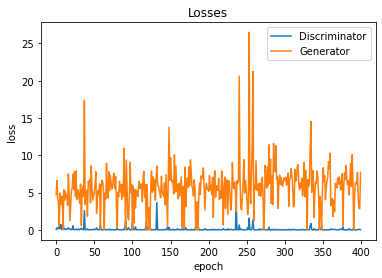

In [ ]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

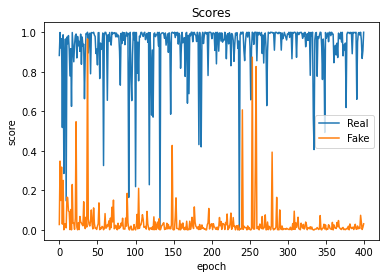

In [ ]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

In [ ]:

print(np.argmin(fid_scores)+1)
min(fid_scores)


352


149.15596279941576

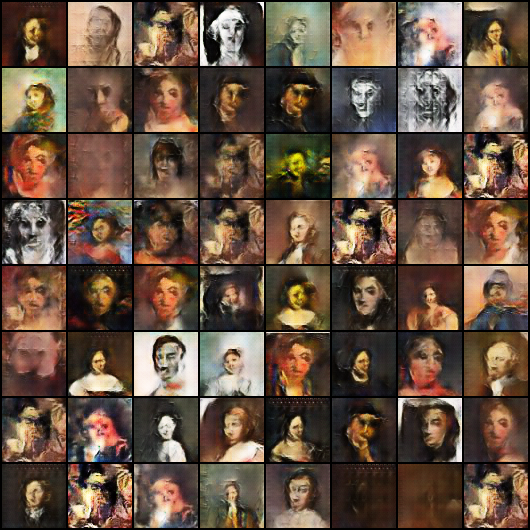

In [ ]:
Image.open(os.path.join(img_dir,'generated-images-0400.png'))

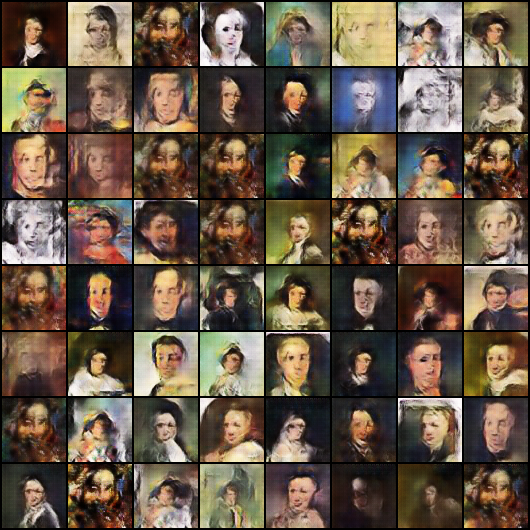

In [ ]:
Image.open(os.path.join(img_dir,'generated-images-{0:0=4d}.png'.format(np.argmin(fid_scores))))

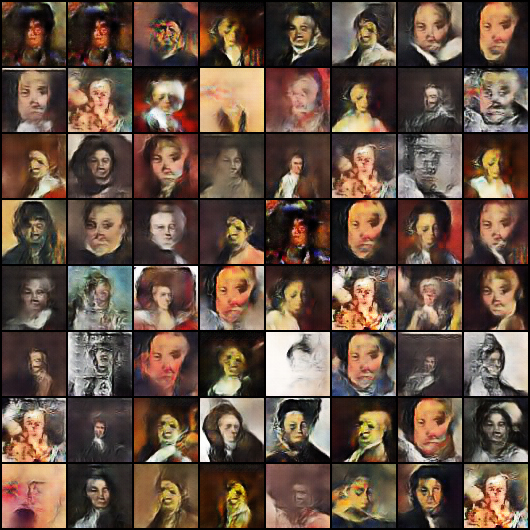

In [ ]:
Image.open(os.path.join(img_dir,'generated-images-{0:0=4d}.png'.format(np.argmin(fid_scores)+1)))

### Dc Gan model on transformed dataset using SGD

In [ ]:
portraits4_dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_SGD/generated_images'
build_slider(portraits4_dir,"portraits generated by DC Gan using BCE and SGD, resized Dataset")

interactive(children=(IntSlider(value=0, description='epoch', max=148), Output()), _dom_classes=('widget-inter…

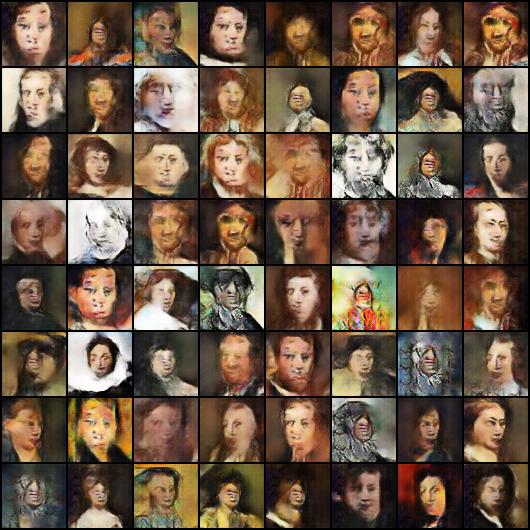

In [ ]:
Image.open(os.path.join(portraits4_dir,'generated-image-0149.png'))

### Dc Gan model on transformed dataset with augmentation  

In [ ]:
augmented_portraits_dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_portraits150_augmented/generated_images'

In [ ]:
build_slider(augmented_portraits_dir,"portraits generated by Relativistic Gan using BCE and Adam, resized Dataset")

interactive(children=(IntSlider(value=0, description='epoch', max=286), Output()), _dom_classes=('widget-inter…

In [ ]:
DcGan_complete_checkpoints='/content/gdrive/MyDrive/VISIOPE/FinalProject/DcGan_portraits150_augmented/total_checkpoints/total_checkpoints'
checkpoint = torch.load(f"{DcGan_complete_checkpoints}/Checkpoint{287}.tar")

In [ ]:
fid= checkpoint['last_fid']
losses_g = checkpoint['generator_losses']
losses_d = checkpoint['discriminator_losses']
fid_scores=checkpoint['fid_score']
real_scores=checkpoint['scores_on_real_imgs']
fake_scores=checkpoint['scores_on_fake_imgs']

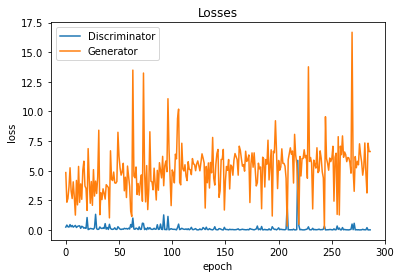

In [ ]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

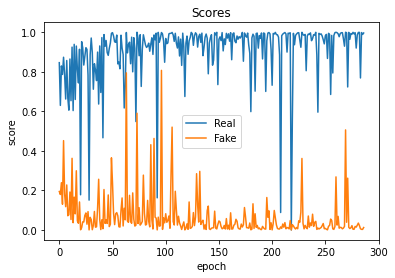

In [ ]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

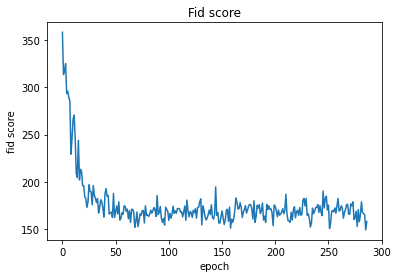

In [ ]:
plt.plot(fid_scores, '-')
plt.xlabel('epoch')
plt.ylabel('fid score')
plt.title('Fid score');

In [ ]:
print(np.argmin(fid_scores)+1)
min(fid_scores)

286


149.2389322989324

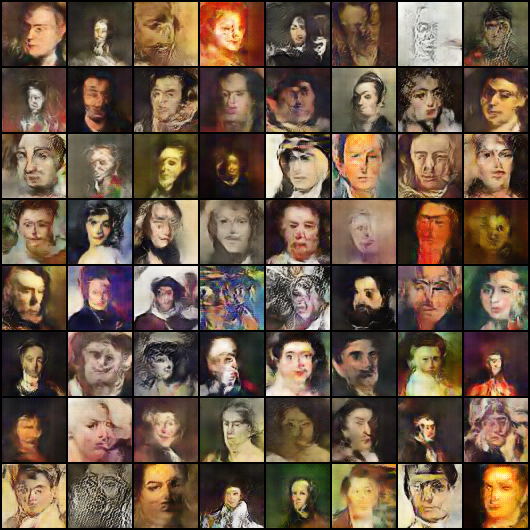

In [ ]:
Image.open(os.path.join(augmented_portraits_dir,'generated-images-0287.png'))

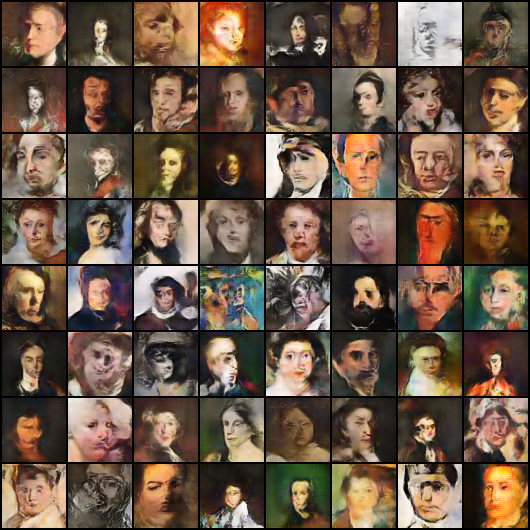

In [ ]:
Image.open(os.path.join(augmented_portraits_dir,'generated-images-{0:0=4d}.png'.format(np.argmin(fid_scores)+1)))

### Least Square Gan on transformed dataset

In [ ]:
lsGan_dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/lsGan/generated_images'
build_slider(lsGan_dir,"portraits generated by Least Square Gan using BCE and Adam, resized Dataset")

interactive(children=(IntSlider(value=0, description='epoch', max=399), Output()), _dom_classes=('widget-inter…

In [ ]:
print(np.argmin(fid_scores)+1)
min(fid_scores)

316


132.48576792698364

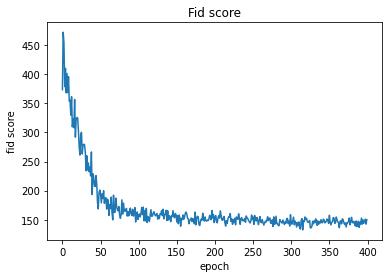

In [ ]:
plt.plot(fid_scores, '-')
plt.xlabel('epoch')
plt.ylabel('fid score')
plt.title('Fid score');

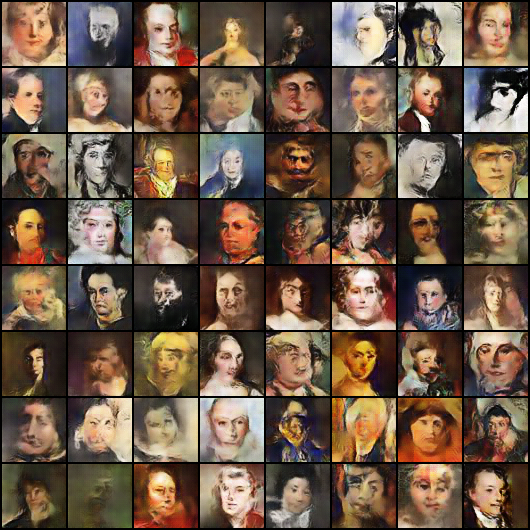

In [ ]:
Image.open(os.path.join(lsGan_dir,'generated-images-{0:0=4d}.png'.format(np.argmin(fid_scores)+1)))

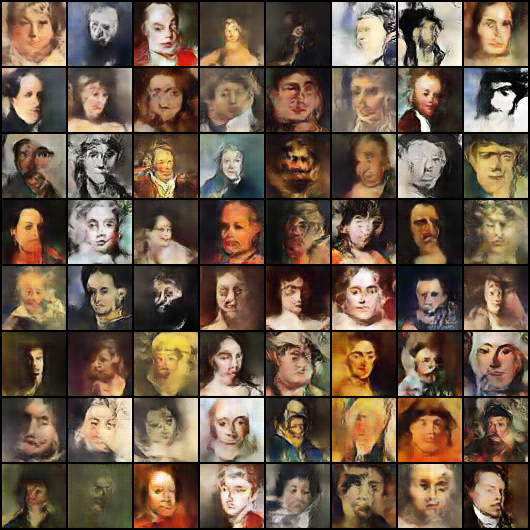

In [ ]:
Image.open(os.path.join(lsGan_dir,'generated-images-0300.png'))

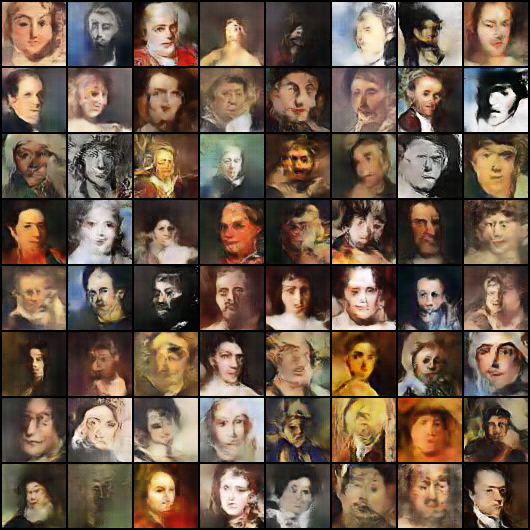

In [ ]:
Image.open(os.path.join(lsGan_dir,'generated-images-0400.png'))

### Least Square Gan on transformed Dataset with augmentation

In [ ]:
DcGan_complete_checkpoints='/content/gdrive/MyDrive/VISIOPE/FinalProject/lsGan_augmented/total_checkpoints'
checkpoint = torch.load(f"{DcGan_complete_checkpoints}/Checkpoint{400}.tar")
losses_g = checkpoint['generator_losses']
losses_d = checkpoint['discriminator_losses']
fid_score=checkpoint['fid_score']

In [ ]:
augm_lsGan_dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/lsGan_augmented/generated_images'
build_slider(augm_lsGan_dir,"portraits generated by Least Square Gan using BCE and Adam, resized Dataset")

interactive(children=(IntSlider(value=0, description='epoch', max=399), Output()), _dom_classes=('widget-inter…

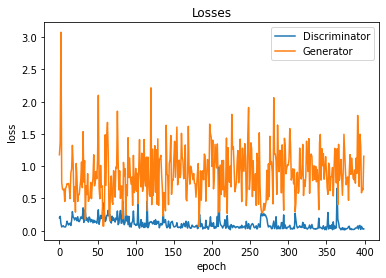

In [ ]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

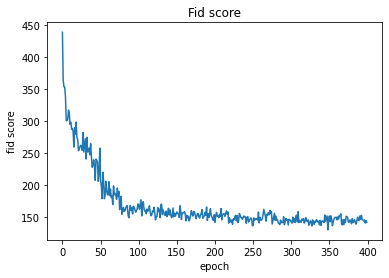

In [ ]:
plt.plot(fid_score, '-')
plt.xlabel('epoch')
plt.ylabel('fid score')
plt.title('Fid score');

In [ ]:
print(np.argmin(fid_score)+1)
min(fid_score)

349


130.19736459103243

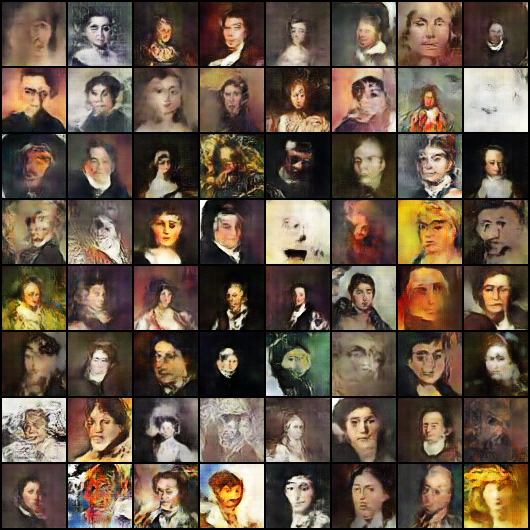

In [ ]:
Image.open(os.path.join(augm_lsGan_dir,'generated-images-0300.png'))

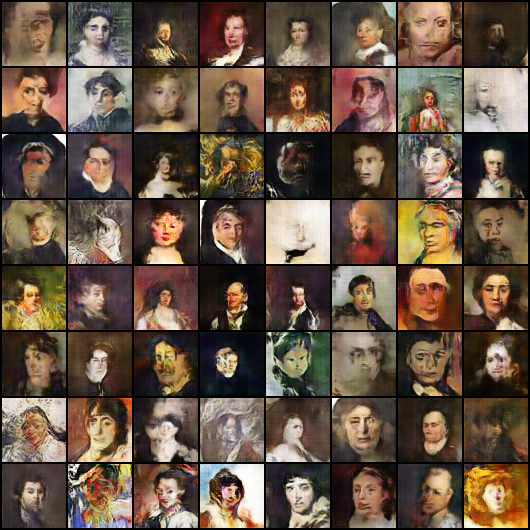

In [ ]:
Image.open(os.path.join(augm_lsGan_dir,'generated-images-0400.png'))

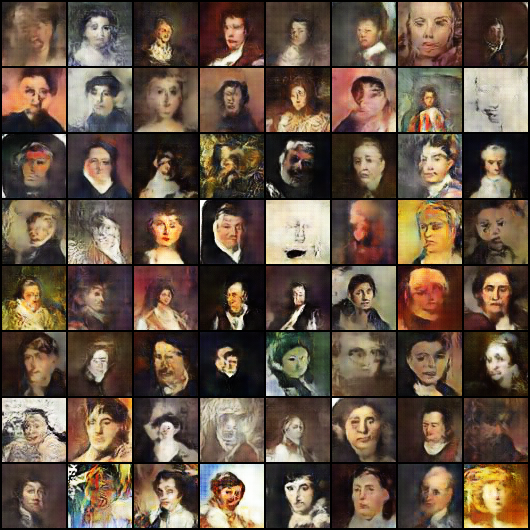

In [ ]:
Image.open(os.path.join(augm_lsGan_dir,'generated-images-{0:0=4d}.png'.format(np.argmin(fid_scores)+1)))

### Relativistic Gan on transformed dataset

In [ ]:
relGan_dir='/content/gdrive/MyDrive/VISIOPE/FinalProject/ReLgan/generated_images'
build_slider(relGan_dir,"portraits generated by Relativistic Gan using BCE and Adam, resized Dataset")

interactive(children=(IntSlider(value=0, description='epoch', max=299), Output()), _dom_classes=('widget-inter…

In [ ]:
fid_scores=torch.load("/content/gdrive/MyDrive/VISIOPE/FinalProject/ReLgan/fid_relgan.tar")

In [ ]:
print(np.argmin(fid_scores)+1)
min(fid_scores)

293


135.1225749081547

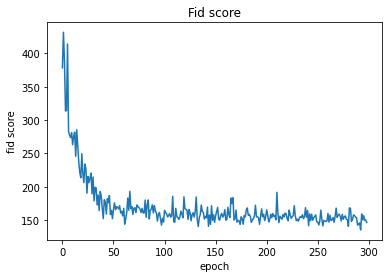

In [ ]:
plt.plot(fid_scores, '-')
plt.xlabel('epoch')
plt.ylabel('fid score')
plt.title('Fid score');

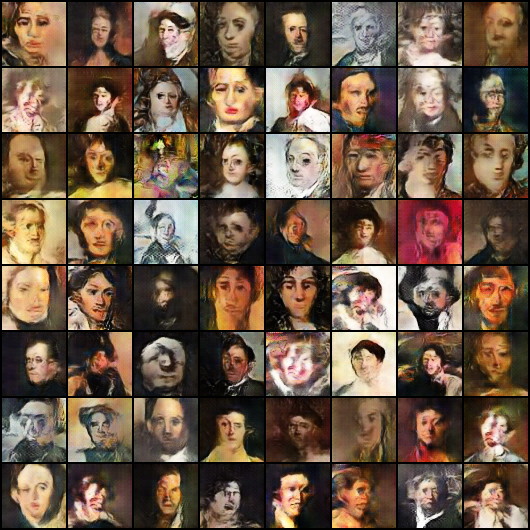

In [ ]:
Image.open(os.path.join(relGan_dir,'generated-images-0300.png'))

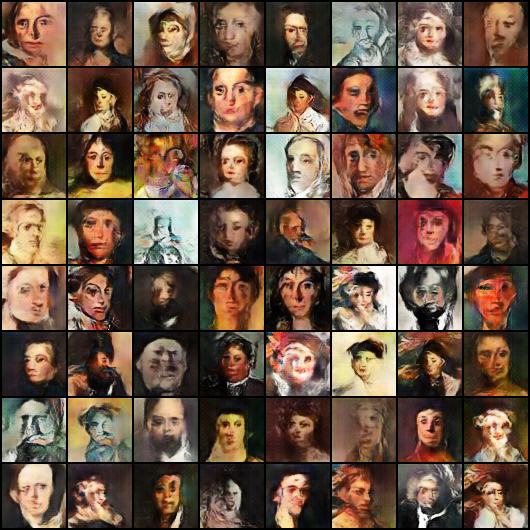

In [ ]:
Image.open(os.path.join(relGan_dir,'generated-images-{0:0=4d}.png'.format(np.argmin(fid_scores)+1)))